In [61]:
#PACKAGES PYTHON

import matplotlib.pyplot as plt
import folium
import pandas as pd
from folium import plugins
import pandas as pd
import json
from folium.plugins import TimestampedGeoJson
from geopy.distance import geodesic
import plotly.express as px
import geopandas as gpd
from shapely.geometry import Point
import numpy as np

import pandas as pd
import numpy as np
from geopy.distance import geodesic

In [62]:
#ORGANISATION DU CSV

# Lecture du fichier CSV depuis C:\Téléchargements
df = pd.read_csv(r"h:\Documents\stages\100000drones.csv", sep=";")
print(df.head)
print(df.columns)


<bound method NDFrame.head of                              drone_id constructeur        modele  \
0      000MCT000000000000409151886510           3W    Extra 330S   
1      000MCT000000000000409151886510           3W    Extra 330S   
2                 1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
3                 1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
4                 1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
...                               ...          ...           ...   
99995            1581F4QZ8246B00EF09K          DJI  Mavic 3 Cine   
99996            1581F4QZ8246B00EF09K          DJI  Mavic 3 Cine   
99997            1581F4QZ8246B00EF09K          DJI  Mavic 3 Cine   
99998            1581F4QZ8246B00EF09K          DJI  Mavic 3 Cine   
99999            1581F4QZ8246B00EF09K          DJI  Mavic 3 Cine   

                      updated  \
0      2025-05-18 15:11:16+02   
1      2025-05-18 17:15:40+02   
2      2025-03-05 12:25:57+01   
3      2025-03-05 12:

In [63]:
#On se penche sur la colonne properties, on souhaite extraire "altitude" "hauteur" "vitesse"
# Vérifier que la colonne 'properties' existe
if "properties" in df.columns:
    for index, row in df["properties"].items():
        print(f"--- Ligne {index} ---")
        print(row)
        print()



--- Ligne 0 ---
{"drone":{"drone_id":"000MCT000000000000409151886510", "altitude":203, "hauteur":63, "longitude_depart":1.4013, "latitude_depart":43.65914, "vitesse":null, "route_vraie":null, "date": "2025-05-18T13:11:16Z", "version_protocole":1}, "trame":{"signal":null, "timestamp":1747573876}}

--- Ligne 1 ---
{"drone":{"drone_id":"000MCT000000000000409151886510", "altitude":237, "hauteur":116, "longitude_depart":1.40128, "latitude_depart":43.65917, "vitesse":null, "route_vraie":null, "date": "2025-05-18T15:15:40Z", "version_protocole":1}, "trame":{"signal":null, "timestamp":1747581340}}

--- Ligne 2 ---
{"drone":{"drone_id":"1581E0M6CG9QR0A0EFB", "altitude":76, "hauteur":"2", "longitude_depart":2.3697, "latitude_depart":48.89821, "vitesse":0, "route_vraie":83, "date": "2025-03-05T11:25:57Z", "version_protocole":1}, "trame":{"canal":0, "signal":0, "timestamp":1741173957}}

--- Ligne 3 ---
{"drone":{"drone_id":"1581E0M6CG9QR0A0EFB", "altitude":77, "hauteur":"3", "longitude_depart":2.3

Extraction de vitesse, hauteur et altitude

In [64]:


def clean_json_str(s):
    if s.startswith('{drone":'):
        s = '{"' + s[1:]
    if s.endswith('}}"'):
        s = s[:-1]
    return s

def extract_values(s):
    try:
        s_clean = clean_json_str(s)
        d = json.loads(s_clean)
        drone = d.get('drone', {})
        altitude = drone.get('altitude', None)
        hauteur = drone.get('hauteur', None)
        vitesse = drone.get('vitesse', None)
        return altitude, hauteur, vitesse
    except Exception as e:
        print(f"Erreur extraction valeurs : {e}")
        return None, None, None

# Appliquer sur toute la colonne properties
df[['altitude', 'hauteur', 'vitesse']] = df['properties'].apply(
    lambda s: pd.Series(extract_values(s))
)

print(df[['properties', 'altitude', 'hauteur', 'vitesse']].head())



                                          properties  altitude hauteur  \
0  {"drone":{"drone_id":"000MCT000000000000409151...     203.0    63.0   
1  {"drone":{"drone_id":"000MCT000000000000409151...     237.0   116.0   
2  {"drone":{"drone_id":"1581E0M6CG9QR0A0EFB", "a...      76.0       2   
3  {"drone":{"drone_id":"1581E0M6CG9QR0A0EFB", "a...      77.0       3   
4  {"drone":{"drone_id":"1581E0M6CG9QR0A0EFB", "a...      76.0       2   

   vitesse  
0      NaN  
1      NaN  
2      0.0  
3      0.0  
4      0.0  


In [65]:
#Trouvons la hauteur du drone
# Convertir 'hauteur' en numérique (float), en forçant les erreurs à NaN
df['hauteur'] = pd.to_numeric(df['hauteur'], errors='coerce')

# Calculer hauteur1 = altitude - hauteur
df['hauteur1'] = df['altitude'] - df['hauteur']

print(df[['altitude', 'hauteur', 'hauteur1']].head())


   altitude  hauteur  hauteur1
0     203.0     63.0     140.0
1     237.0    116.0     121.0
2      76.0      2.0      74.0
3      77.0      3.0      74.0
4      76.0      2.0      74.0


Supprimer la colonne 'properties' du DataFrame original

In [66]:
# Supprimer la colonne 'properties' du DataFrame original
df_initial_sans_properties = df

# Faire la concaténation côte à côte
df_drones = pd.concat([df_initial_sans_properties], axis=1)

print(df_drones.head())


                         drone_id constructeur        modele  \
0  000MCT000000000000409151886510           3W    Extra 330S   
1  000MCT000000000000409151886510           3W    Extra 330S   
2             1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
3             1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
4             1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   

                  updated                                         properties  \
0  2025-05-18 15:11:16+02  {"drone":{"drone_id":"000MCT000000000000409151...   
1  2025-05-18 17:15:40+02  {"drone":{"drone_id":"000MCT000000000000409151...   
2  2025-03-05 12:25:57+01  {"drone":{"drone_id":"1581E0M6CG9QR0A0EFB", "a...   
3  2025-03-05 12:22:32+01  {"drone":{"drone_id":"1581E0M6CG9QR0A0EFB", "a...   
4  2025-03-05 12:26:46+01  {"drone":{"drone_id":"1581E0M6CG9QR0A0EFB", "a...   

          y        x  altitude  hauteur  vitesse  hauteur1  
0  43.65846  1.40422     203.0     63.0      NaN     140.0  
1  43.65863 

Création d'un nouveau csv.

In [67]:


colonnes_voulues = [
    'drone_id',
    'constructeur',
    'modele',
    'updated',  # temps
    'y',
    'x',
    'altitude',
    'hauteur',
    'vitesse',
    'hauteur1',
    'properties'
]

df_kepler_ready = df_drones[colonnes_voulues].copy()

df_kepler_ready.to_csv('drones_kepler.csv', index=False)

print("CSV créé avec les colonnes demandées.")


CSV créé avec les colonnes demandées.


MODELISATION DANS KEPLER.GL
pas forcément très pertinente cependant.

TRAVAIL SUR LE FORMAT DES DATES

In [68]:
print(df['updated'].head())
print(df['updated'].dtype)


0    2025-05-18 15:11:16+02
1    2025-05-18 17:15:40+02
2    2025-03-05 12:25:57+01
3    2025-03-05 12:22:32+01
4    2025-03-05 12:26:46+01
Name: updated, dtype: object
object


In [69]:
df['updated'] = pd.to_datetime(df['updated'], utc=True, errors='coerce')
print(df['updated'].dtypes)  # Doit afficher le type de date




datetime64[ns, UTC]


On fonctionne donc en UTC

Les valeurs des vitesses "null" sont changées en valeur 0.

In [70]:
import matplotlib.pyplot as plt

# Assure-toi que 'updated' est datetime (avec fuseau horaire ou en UTC)
df['updated'] = pd.to_datetime(df['updated'], utc=True, errors='coerce')

# Nettoyer la colonne 'vitesse'
df['vitesse'] = pd.to_numeric(df['vitesse'], errors='coerce').fillna(0)
# Trier les données pour plus de clarté
df = df.sort_values(['drone_id', 'updated'])

# Liste des drones uniques
drone_ids = df['drone_id'].unique()






Visualisation des trajectoires

Liste des modèles

In [71]:
print(df["modele"].drop_duplicates())


0                         Extra 330S
18                      Mavic 2 Zoom
29                           Mavic 2
61                     Phantom 4 RTK
496               Phantom 4 Pro V2.0
765                      Mavic 2 Pro
22503                MAVIC 2 PRO L1P
25719                           F4-1
25886                 MATRICE 210 V2
25949                Matrice 300 RTK
30835        Mavic 2 Enterprise Dual
52195    Mavic 2 Enterprise Advanced
53135             Mavic 2 Enterprise
53317                         Air 2S
57132                        Mavic 3
62466                Mavic 3 Classic
67127                        MAVIC 3
91647                   Mavic 3 Cine
Name: modele, dtype: object


In [72]:
# Lire le fichier CSV
df_clean = pd.read_csv('drones_kepler.csv')

# Afficher les 5 premières lignes
print(df_clean.head())

                         drone_id constructeur        modele  \
0  000MCT000000000000409151886510           3W    Extra 330S   
1  000MCT000000000000409151886510           3W    Extra 330S   
2             1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
3             1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
4             1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   

                  updated         y        x  altitude  hauteur  vitesse  \
0  2025-05-18 15:11:16+02  43.65846  1.40422     203.0     63.0      NaN   
1  2025-05-18 17:15:40+02  43.65863  1.40362     237.0    116.0      NaN   
2  2025-03-05 12:25:57+01  48.89824  2.36966      76.0      2.0      0.0   
3  2025-03-05 12:22:32+01  48.89822  2.36970      77.0      3.0      0.0   
4  2025-03-05 12:26:46+01  48.89824  2.36966      76.0      2.0      0.0   

   hauteur1                                         properties  
0     140.0  {"drone":{"drone_id":"000MCT000000000000409151...  
1     121.0  {"drone":{"dron

In [73]:
# S'assurer que 'updated' est bien en datetime
df_clean['updated'] = pd.to_datetime(df_clean['updated'])

# Trier les données par drone et timestamp
df_clean = df_clean.sort_values(by=['drone_id', 'updated']).reset_index(drop=True)

# Initialiser la colonne des vitesses calculées
df_clean['vitesse_calculee'] = 0.0

# Grouper par drone_id
for drone_id, group in df_clean.groupby('drone_id'):
    idxs = group.index
    for i in range(1, len(group)):
        idx_prev = idxs[i - 1]
        idx_curr = idxs[i]

        # Extraire les coordonnées (lat, lon)
        coord_prev = (df_clean.loc[idx_prev, 'y'], df_clean.loc[idx_prev, 'x'])
        coord_curr = (df_clean.loc[idx_curr, 'y'], df_clean.loc[idx_curr, 'x'])

        # Calcul de la distance (mètres)
        distance = geodesic(coord_prev, coord_curr).meters

        # Calcul du temps (secondes)
        t1 = df_clean.loc[idx_prev, 'updated']
        t2 = df_clean.loc[idx_curr, 'updated']
        delta_t = (t2 - t1).total_seconds()

        # Calcul de la vitesse (m/s)
        vitesse = distance / delta_t if delta_t > 0 else 0.0

        df_clean.loc[idx_curr, 'vitesse_calculee'] = vitesse

# Afficher les résultats
print(df_clean[['drone_id', 'updated', 'y', 'x', 'vitesse_calculee', 'modele', 'vitesse' , 'hauteur','altitude', 'hauteur1', 'properties']].head(10))


                         drone_id                    updated         y  \
0  000MCT000000000000409151886510  2025-05-18 15:11:16+02:00  43.65846   
1  000MCT000000000000409151886510  2025-05-18 17:15:40+02:00  43.65863   
2             1581E0M6CG9QR0A0EFB  2025-03-05 12:20:31+01:00  48.89822   
3             1581E0M6CG9QR0A0EFB  2025-03-05 12:20:44+01:00  48.89822   
4             1581E0M6CG9QR0A0EFB  2025-03-05 12:20:46+01:00  48.89822   
5             1581E0M6CG9QR0A0EFB  2025-03-05 12:20:47+01:00  48.89822   
6             1581E0M6CG9QR0A0EFB  2025-03-05 12:20:57+01:00  48.89823   
7             1581E0M6CG9QR0A0EFB  2025-03-05 12:21:00+01:00  48.89823   
8             1581E0M6CG9QR0A0EFB  2025-03-05 12:21:04+01:00  48.89822   
9             1581E0M6CG9QR0A0EFB  2025-03-05 12:22:13+01:00  48.89821   

         x  vitesse_calculee        modele  vitesse  hauteur  altitude  \
0  1.40422          0.000000    Extra 330S      NaN     63.0     203.0   
1  1.40362          0.006961    Extra

Exemple des trajectoires d'un drone

In [74]:


from geopy.distance import geodesic

# Filtrer les données pour ce drone spécifique
drone_id = '1581F4QZ8246B00EF09K'
df_drone = df[df['drone_id'] == drone_id].sort_values(by='updated')

# Calcul des bornes géographiques
min_lat, max_lat = df_drone['y'].min(), df_drone['y'].max()
min_lon, max_lon = df_drone['x'].min(), df_drone['x'].max()
center_lat = (min_lat + max_lat) / 2
center_lon = (min_lon + max_lon) / 2

# Déterminer le niveau de zoom en fonction de la dispersion
lat_diff = max_lat - min_lat
lon_diff = max_lon - min_lon
max_diff = max(lat_diff, lon_diff)

if max_diff < 0.001:
    zoom = 18
elif max_diff < 0.01:
    zoom = 15
elif max_diff < 0.1:
    zoom = 12
elif max_diff < 1:
    zoom = 10
else:
    zoom = 8

# Créer la carte centrée
m = folium.Map(location=[center_lat, center_lon], zoom_start=zoom, tiles='OpenStreetMap')

# Ajouter la trajectoire du drone
coords = list(zip(df_drone['y'], df_drone['x']))  # (lat, lon)
folium.PolyLine(coords, color='blue', weight=3, opacity=0.8).add_to(m)

# Marqueurs avec popups
previous_point = None
for idx, row in df_drone.iterrows():
    lat, lon = row['y'], row['x']
    vitesse = row['vitesse'] if pd.notna(row['vitesse']) else 0

    if previous_point is None:
        distance = 0
    else:
        distance = geodesic((lat, lon), previous_point).meters

    popup_text = f"Vitesse : {vitesse} m/s<br>Distance depuis point précédent : {distance:.2f} m"

    folium.CircleMarker(location=[lat, lon],
                        radius=4,
                        color='red',
                        fill=True,
                        popup=popup_text).add_to(m)

    previous_point = (lat, lon)

# Sauvegarder la carte en fichier HTML
m.save('carte_drone_1581F4QZ8246B00EF09K.html')


In [75]:
print(df_clean.head(30))

                          drone_id constructeur        modele  \
0   000MCT000000000000409151886510           3W    Extra 330S   
1   000MCT000000000000409151886510           3W    Extra 330S   
2              1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
3              1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
4              1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
5              1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
6              1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
7              1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
8              1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
9              1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
10             1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
11             1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
12             1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
13             1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
14             1581E0M6CG

Ajout des colonnes Trajectoire, distance, vitesse ascensionnelle, temps

In [76]:
import pandas as pd
import numpy as np
from geopy.distance import geodesic

# 1. Convertir 'updated' en datetime avec UTC
df_clean['updated'] = pd.to_datetime(df_clean['updated'], utc=True)

# 2. Trier par drone_id et timestamp
df_clean = df_clean.sort_values(by=['drone_id', 'updated']).reset_index(drop=True)

# 3. Calcul du temps écoulé (delta_t) en secondes
df_clean['delta_t'] = df_clean.groupby('drone_id')['updated'].diff().dt.total_seconds()

# 4. Calcul de la vitesse verticale vz (altitude / temps)
df_clean['vz'] = df_clean.groupby('drone_id')['hauteur1'].diff() / df_clean['delta_t']

# 5. Calcul de la distance entre points GPS successifs (avec x = lon, y = lat)
def compute_distance(row):
    i = row.name
    if i == 0 or df_clean.loc[i, 'drone_id'] != df_clean.loc[i - 1, 'drone_id']:
        return 0
    coord1 = (df_clean.loc[i - 1, 'y'], df_clean.loc[i - 1, 'x'])  # (lat, lon)
    coord2 = (df_clean.loc[i, 'y'], df_clean.loc[i, 'x'])          # (lat, lon)
    return geodesic(coord1, coord2).m

df_clean['distance'] = df_clean.apply(compute_distance, axis=1)

# 6. Détection de nouvelle trajectoire si delta_t > 5 minutes ou changement de drone
df_clean['new_traj'] = (
    (df_clean['delta_t'] > 300) |
    (df_clean['drone_id'] != df_clean['drone_id'].shift())
).astype(int)

# 7. Attribution d’un ID de trajectoire unique
df_clean['traj_id'] = df_clean.groupby('drone_id')['new_traj'].cumsum()

# 8. Calcul du temps total et distance totale pour chaque trajectoire
traj_stats = df_clean.groupby(['drone_id', 'traj_id']).agg(
    temps_total=('delta_t', 'sum'),
    distance_totale=('distance', 'sum')
).reset_index()

# Nettoyer les colonnes potentielles en doublon avant merge
for col in ['temps_total', 'distance_totale', 'temps_total_x', 'temps_total_y', 'distance_totale_x', 'distance_totale_y']:
    if col in df_clean.columns:
        df_clean.drop(columns=[col], inplace=True)

# 9. Fusion des statistiques dans le dataframe principal
df_clean = df_clean.merge(traj_stats, on=['drone_id', 'traj_id'], how='left')

# 10. Nettoyage de la colonne temporaire
df_clean.drop(columns=['new_traj'], inplace=True)

# 11. Affichage
print(df_clean.head(30))


                          drone_id constructeur        modele  \
0   000MCT000000000000409151886510           3W    Extra 330S   
1   000MCT000000000000409151886510           3W    Extra 330S   
2              1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
3              1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
4              1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
5              1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
6              1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
7              1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
8              1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
9              1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
10             1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
11             1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
12             1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
13             1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
14             1581E0M6CG

In [77]:
print(df_clean.columns)  # pour voir si 'vz' est là


Index(['drone_id', 'constructeur', 'modele', 'updated', 'y', 'x', 'altitude',
       'hauteur', 'vitesse', 'hauteur1', 'properties', 'vitesse_calculee',
       'delta_t', 'vz', 'distance', 'traj_id', 'temps_total',
       'distance_totale'],
      dtype='object')


Plot des vitesses rapportées au temps

C:\Users\CYTech Student\AppData\Local\Temp\ipykernel_2756\731806854.py:28: UserWarning: Attempting to set identical low and high xlims makes transformation singular; automatically expanding.
  ax.set_xlim(df_sub['updated'].min(), df_sub['updated'].max())


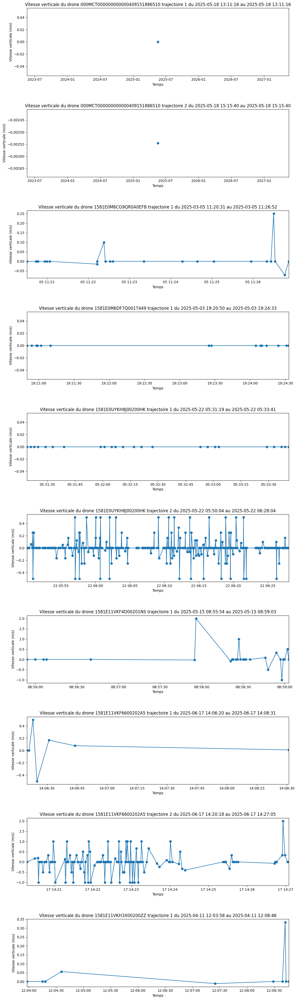

In [78]:
import matplotlib.pyplot as plt


df_clean['vz'] = pd.to_numeric(df_clean['vz'], errors='coerce').fillna(0)

# 2. Trier par drone_id, traj_id et temps
df_clean = df_clean.sort_values(['drone_id', 'traj_id', 'updated'])

# 3. Limiter le nombre de groupes affichés (optionnel)
max_plots = 10  # Nombre max de trajectoires à afficher
group_keys = list(df_clean.groupby(['drone_id', 'traj_id']).groups.keys())[:max_plots]

# 4. Créer la figure et les axes
fig, axes = plt.subplots(len(group_keys), 1, figsize=(12, 4*len(group_keys)), sharex=False)
if len(group_keys) == 1:
    axes = [axes]

# 5. Tracer chaque trajectoire sur son subplot
for ax, (drone, traj) in zip(axes, group_keys):
    df_sub = df_clean[(df_clean['drone_id'] == drone) & (df_clean['traj_id'] == traj)]
    if df_sub.empty:
        continue

    start = df_sub['updated'].min().strftime('%Y-%m-%d %H:%M:%S')
    end = df_sub['updated'].max().strftime('%Y-%m-%d %H:%M:%S')

    ax.plot(df_sub['updated'], df_sub['vz'], marker='o', linestyle='-')
    ax.set_xlim(df_sub['updated'].min(), df_sub['updated'].max())

    ax.set_title(f"Vitesse verticale du drone {drone} trajectoire {traj} du {start} au {end}")
    ax.set_xlabel("Temps")
    ax.set_ylabel("Vitesse verticale (m/s)")

plt.tight_layout()
plt.subplots_adjust(hspace=0.5)
plt.show()


In [79]:
print(df_clean.columns)


Index(['drone_id', 'constructeur', 'modele', 'updated', 'y', 'x', 'altitude',
       'hauteur', 'vitesse', 'hauteur1', 'properties', 'vitesse_calculee',
       'delta_t', 'vz', 'distance', 'traj_id', 'temps_total',
       'distance_totale'],
      dtype='object')


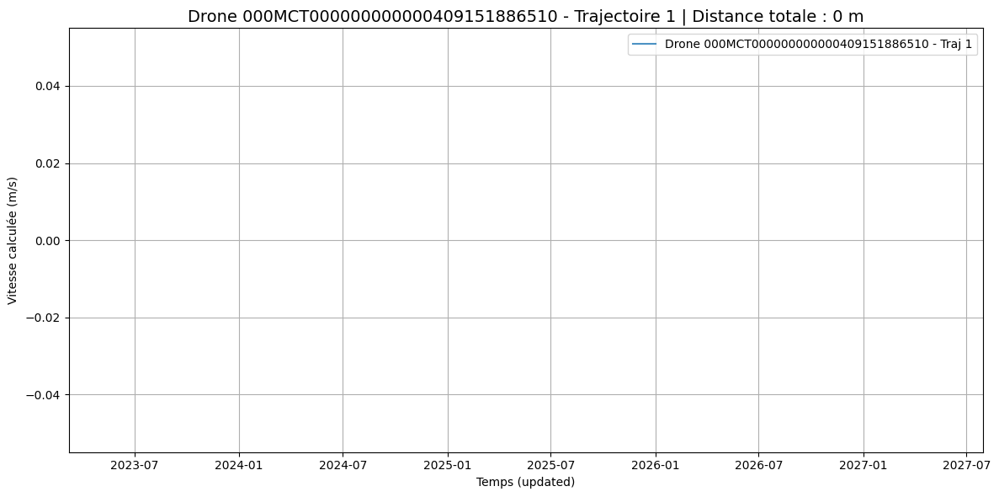

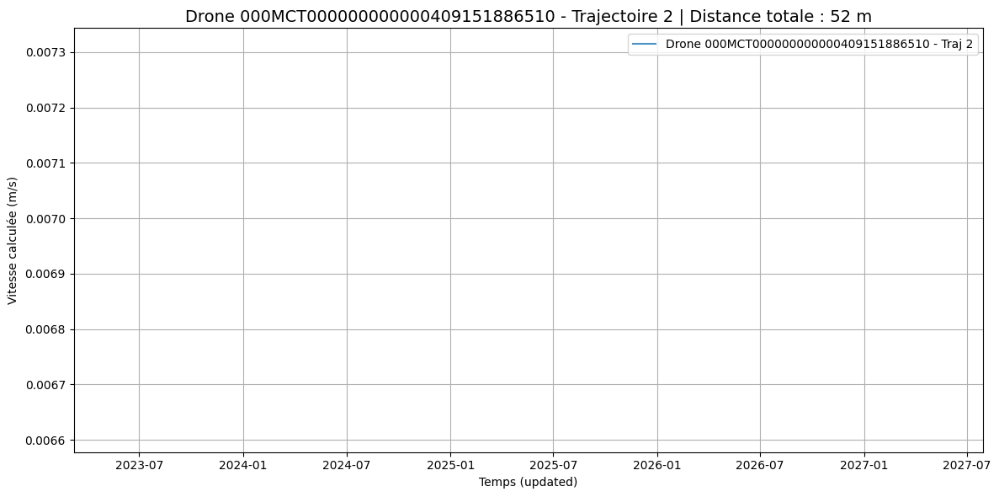

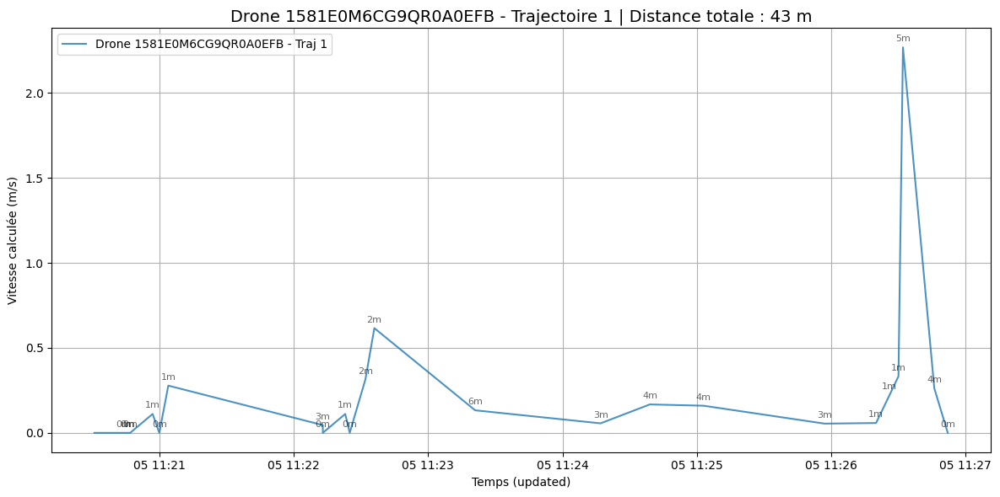

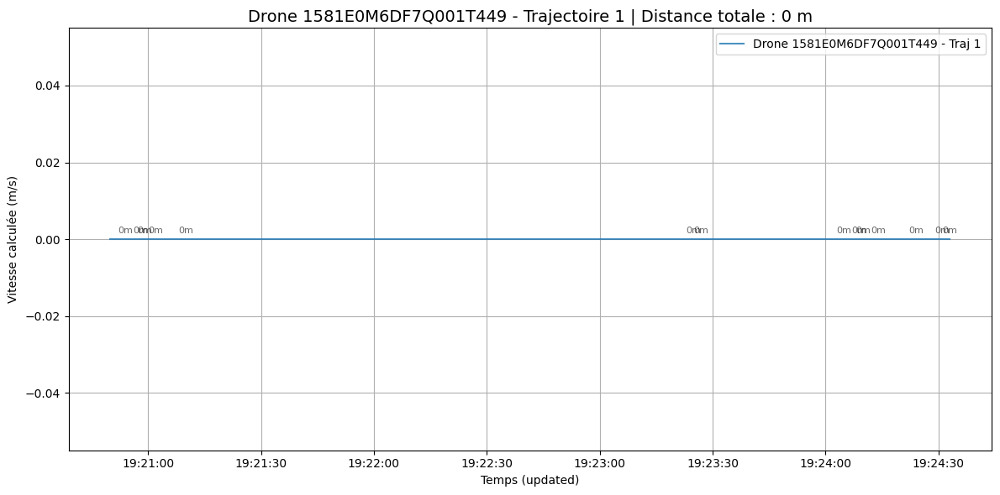

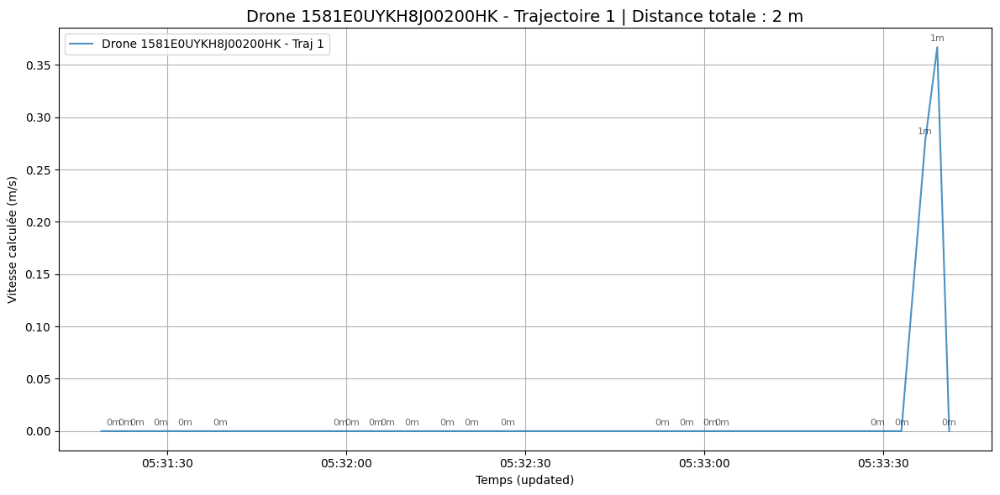

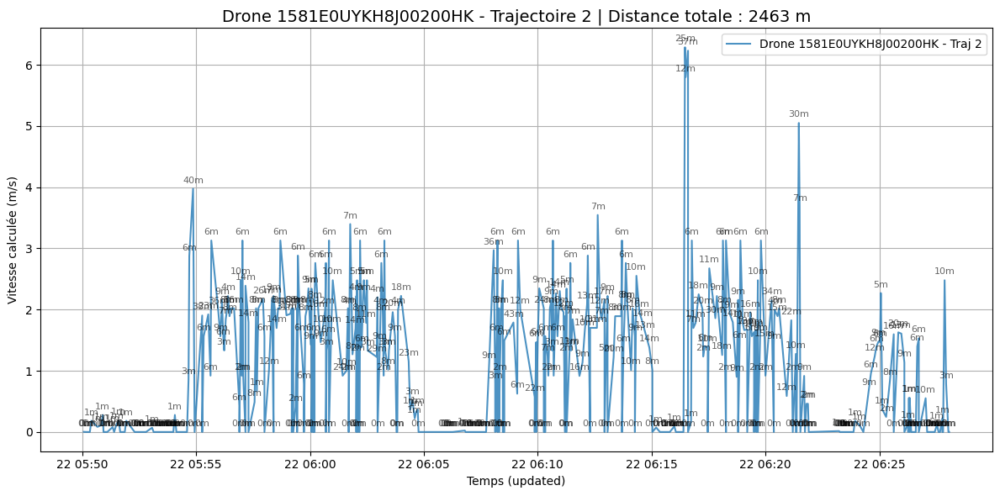

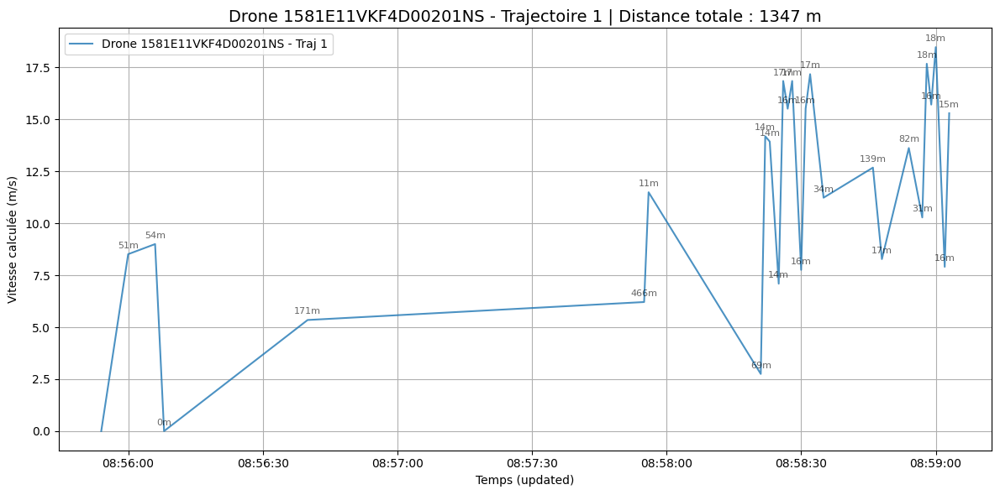

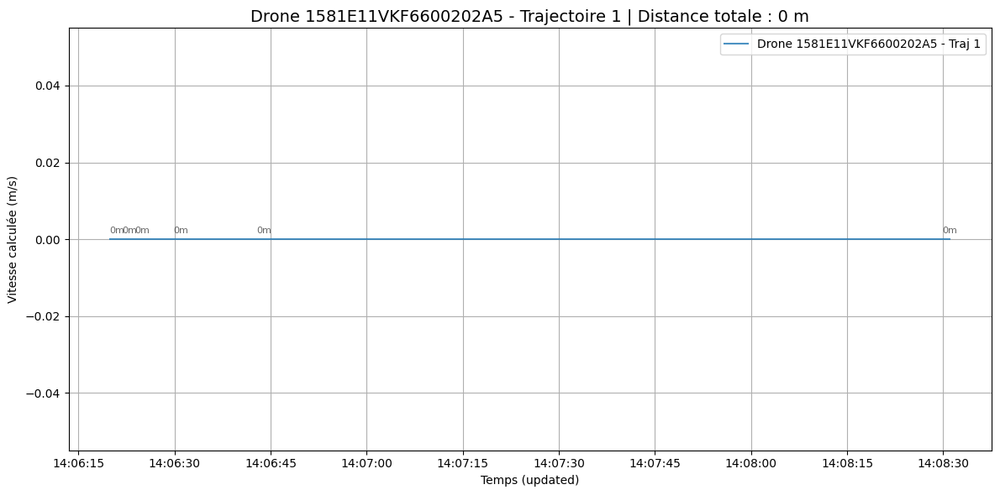

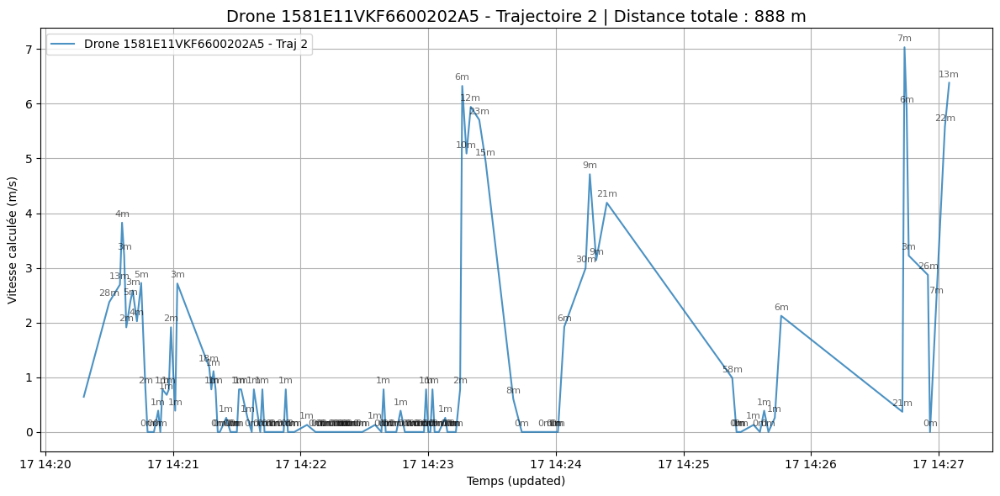

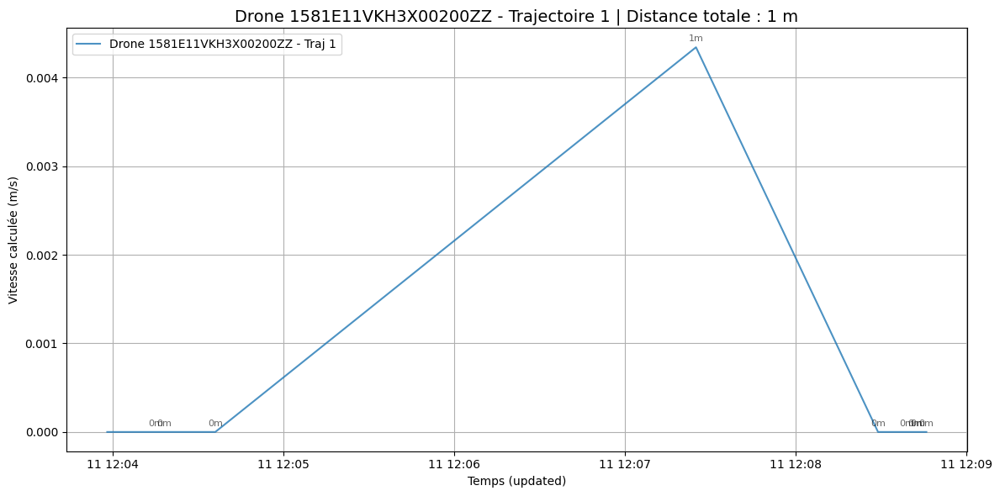

In [80]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Assurer que 'updated' est bien en datetime
df_clean['updated'] = pd.to_datetime(df_clean['updated'])

# Obtenir les 10 premières combinaisons uniques (drone_id, traj_id)
top_10_traj = df_clean[['drone_id', 'traj_id']].drop_duplicates().head(10)

# Boucler sur les 10 premières trajectoires
for index, row in top_10_traj.iterrows():
    drone_id = row['drone_id']
    traj_id = row['traj_id']

    group = df_clean[(df_clean['drone_id'] == drone_id) & (df_clean['traj_id'] == traj_id)]
    group = group.sort_values('updated')

    # Calcul de la distance totale
    distance_totale = group['distance'].sum()

    # Définir la taille de la figure
    plt.figure(figsize=(12, 6))

    # Tracer la courbe de vitesse
    plt.plot(group['updated'], group['vitesse_calculee'],
             label=f'Drone {drone_id} - Traj {traj_id}',
             color='tab:blue', alpha=0.8)

    # Annoter chaque point avec la distance
    for i in range(1, len(group)):
        x = group.iloc[i]['updated']
        y = group.iloc[i]['vitesse_calculee']
        dist = group.iloc[i]['distance']
        plt.annotate(f"{dist:.0f}m", (x, y),
                     textcoords="offset points", xytext=(0, 5),
                     ha='center', fontsize=8, alpha=0.6)

    # Titre avec distance totale
    plt.title(
        f"Drone {drone_id} - Trajectoire {traj_id} | Distance totale : {distance_totale:.0f} m",
        fontsize=14
    )
    plt.xlabel("Temps (updated)")
    plt.ylabel("Vitesse calculée (m/s)")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


In [81]:
print(df_clean.columns)

Index(['drone_id', 'constructeur', 'modele', 'updated', 'y', 'x', 'altitude',
       'hauteur', 'vitesse', 'hauteur1', 'properties', 'vitesse_calculee',
       'delta_t', 'vz', 'distance', 'traj_id', 'temps_total',
       'distance_totale'],
      dtype='object')


Ajout de la distance entre télécommande et point le plus loin (portée)

In [82]:

# Fonction pour calculer la distance max au point (x0, y0)
def compute_max_distance_to_start(group):
    x0, y0 = group.iloc[0][['x', 'y']]  # point de la télécommande
    distances = np.sqrt((group['x'] - x0)**2 + (group['y'] - y0)**2)
    max_distance = distances.max()
    group['distance_max_telecommande'] = max_distance
    return group

# Appliquer la fonction par trajectoire
df_clean = df_clean.groupby(['drone_id', 'traj_id'], group_keys=False).apply(compute_max_distance_to_start)

print(df_clean.head(30))



                          drone_id constructeur        modele  \
0   000MCT000000000000409151886510           3W    Extra 330S   
1   000MCT000000000000409151886510           3W    Extra 330S   
2              1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
3              1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
4              1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
5              1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
6              1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
7              1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
8              1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
9              1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
10             1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
11             1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
12             1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
13             1581E0M6CG9QR0A0EFB          DJI  Mavic 2 Zoom   
14             1581E0M6CG

Extraction de Latitude_départ et longitude_départ

In [83]:


def clean_json_str(s):
    if s.startswith('{drone":'):
        s = '{"' + s[1:]
    if s.endswith('}}"'):
        s = s[:-1]
    return s

def extract_lat_lon(s):
    try:
        s_clean = clean_json_str(s)
        d = json.loads(s_clean)
        drone = d.get('drone', {})
        latitude_depart = drone.get('latitude_depart', None)
        longitude_depart = drone.get('longitude_depart', None)
        return latitude_depart, longitude_depart
    except Exception as e:
        print(f"Erreur extraction coordonnées : {e}")
        return None, None

# Application sur df_clean
df_clean[['latitude_depart', 'longitude_depart']] = df_clean['properties'].apply(
    lambda s: pd.Series(extract_lat_lon(s))
)

# Affichage de vérification
print(df_clean[['latitude_depart', 'longitude_depart']].head(10))


   latitude_depart  longitude_depart
0         43.65914           1.40130
1         43.65917           1.40128
2         48.89821           2.36970
3         48.89821           2.36970
4         48.89821           2.36970


On a certaines valeurs qui sont aberrantes et liées à un mauvais renseignement de la donnée par le drone.
On change les latitudes/longitudes aberrantes par 0.

In [90]:
import numpy as np

# Définir les bornes valides de la France métropolitaine
lat_min, lat_max = 41.0, 51.5
lon_min, lon_max = -5.5, 9.5

# Masques de validité
lat_valid = df_clean['latitude_depart'].between(lat_min, lat_max)
lon_valid = df_clean['longitude_depart'].between(lon_min, lon_max)

# Remplacer par NaN si hors des bornes
df_clean.loc[~lat_valid, 'latitude_depart'] = np.nan
df_clean.loc[~lon_valid, 'longitude_depart'] = np.nan


Ajout de la colonne Distance_depart (portée)

In [94]:
import numpy as np

def haversine(lat1, lon1, lat2, lon2):
    R = 6371000  # rayon terrestre en mètres
    phi1, phi2 = np.radians(lat1), np.radians(lat2)
    dphi = np.radians(lat2 - lat1)
    dlambda = np.radians(lon2 - lon1)

    a = np.sin(dphi/2)**2 + np.cos(phi1) * np.cos(phi2) * np.sin(dlambda/2)**2
    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1 - a))

    return R * c  # distance en mètres

# Distance par rapport au point de départ GPS
df_clean['distance_from_depart'] = df_clean.apply(
    lambda row: haversine(row['latitude_depart'], row['longitude_depart'], row['y'], row['x']), axis=1
)

# Distance maximale par groupe
df_clean['distance_depart'] = df_clean.groupby(['drone_id', 'traj_id'])['distance_from_depart'].transform('max')
# Remplacer la colonne par une version formatée en string
df_clean['distance_depart'] = df_clean['distance_depart'].apply(lambda x: f"{x:.2f}")

df_clean.drop(columns=['distance_from_depart'], inplace=True)


print(df_clean[['distance_depart']].head(50))


   distance_depart
0           246.77
1           197.59
2             4.95
3             4.95
4             4.95
5             4.95
6             4.95
7             4.95
8             4.95
9             4.95
10            4.95
11            4.95
12            4.95
13            4.95
14            4.95
15            4.95
16            4.95
17            4.95
18            4.95
19            4.95
20            4.95
21            4.95
22            4.95
23            4.95
24            4.95
25            4.95
26             nan
27             nan
28             nan
29             nan
30             nan
31             nan
32             nan
33             nan
34             nan
35             nan
36             nan
37             nan
38             nan
39             nan
40             nan
41             nan
42             nan
43             nan
44             nan
45             nan
46             nan
47             nan
48             nan
49             nan


In [95]:
(df_clean[['properties']])

,properties
0,"{""drone"":{""drone_id"":""000MCT000000000000409151..."
1,"{""drone"":{""drone_id"":""000MCT000000000000409151..."
2,"{""drone"":{""drone_id"":""1581E0M6CG9QR0A0EFB"", ""a..."
3,"{""drone"":{""drone_id"":""1581E0M6CG9QR0A0EFB"", ""a..."
4,"{""drone"":{""drone_id"":""1581E0M6CG9QR0A0EFB"", ""a..."
...,...
99995,"{""drone"":{""drone_id"":""1581F4QZ8246B00EF09K"", ""..."
99996,"{""drone"":{""drone_id"":""1581F4QZ8246B00EF09K"", ""..."
99997,"{""drone"":{""drone_id"":""1581F4QZ8246B00EF09K"", ""..."
99998,"{""drone"":{""drone_id"":""1581F4QZ8246B00EF09K"", ""..."


Standardisation du nom des modèles

In [96]:
print(df_clean.columns)

Index(['drone_id', 'constructeur', 'modele', 'updated', 'y', 'x', 'altitude',
       'hauteur', 'vitesse', 'hauteur1', 'properties', 'vitesse_calculee',
       'delta_t', 'vz', 'distance', 'traj_id', 'temps_total',
       'distance_totale', 'distance_max_telecommande', 'latitude_depart',
       'longitude_depart', 'distance_depart'],
      dtype='object')


In [104]:
import pandas as pd
import unidecode
from rapidfuzz import process

# === 1. Liste officielle des modèles ===
modeles_ref = [
    "Mini 4K", "Mini 3 Pro", "Mini 3", "Mini 2 SE", "Mini SE", "Air 3S", "Air 3", "Air 2S",
    "Mavic 4 Pro", "Mavic 3 Pro", "Mavic 3 Classic", "Mavic 3", "Mavic 2", "Mavic Pro",
    "Mavic Pro Platinum", "Avata", "FPV (original)", "Inspire 3", "Inspire 2",
    "Matrice 300 RTK", "Matrice 350 RTK", "Matrice 30", "Matrice 30T", "Matrice 400",
    "Matrice 4E", "Matrice 4T", "Mavic 3T", "Mavic 3E", "Mavic 3M",
    "Mavic 2 Enterprise Dual", "Mavic 2 Enterprise Advanced", "Agras T50", "Agras T25",
    "T20", "T25P", "T30", "T60", "T100", "MG-1", "Phantom 4 Pro", "Phantom 4 Advanced",
    "Spreading Wings S1000", "Evo Lite+", "Evo Nano+", "Typhoon H", "Typhoon H Plus",
    "Breeze", "Ghost Drone 2.0", "Atom 2", "Anafi", "Anafi USA", "Mavic 2 Zoom",
    "Phantom 4 RTK", "Extra 330S"
]

# === 2. Fonction de nettoyage des chaînes ===
def normalize(s):
    if pd.isna(s):
        return ""
    s = str(s)
    s = unidecode.unidecode(s).lower()
    s = s.replace("-", " ").replace("_", " ").strip()
    return s

# === 3. Normaliser la liste de référence ===
normalized_ref = {normalize(m): m for m in modeles_ref}
normalized_ref_list = list(normalized_ref.keys())

# === 4. Fonction de correspondance floue robuste ===
def match_model(s, threshold=85):
    s_norm = normalize(s)
    result = process.extractOne(s_norm, normalized_ref_list, score_cutoff=threshold)
    if result:
        match, score, _ = result
        return normalized_ref[match]
    return None

# === 5. Optimisation : matching sur valeurs uniques ===
valeurs_uniques = df_clean["modele"].dropna().unique()
correspondance = {val: match_model(val) for val in valeurs_uniques}

# === 6. Remplacement dans le DataFrame ===
df_clean["modele_standardise"] = df_clean["modele"].map(correspondance)

# === 7. (Optionnel) Export des modèles non reconnus ===
non_reconnus = {k: v for k, v in correspondance.items() if v is None}
pd.Series(non_reconnus).to_csv("modeles_non_reconnus.csv")

# === 8. (Optionnel) Affichage pour vérification ===
print(df_clean[["modele", "modele_standardise"]].head(100))


           modele modele_standardise
0      Extra 330S         Extra 330S
1      Extra 330S         Extra 330S
2    Mavic 2 Zoom       Mavic 2 Zoom
3    Mavic 2 Zoom       Mavic 2 Zoom
4    Mavic 2 Zoom       Mavic 2 Zoom
..            ...                ...
95  Phantom 4 RTK      Phantom 4 RTK
96  Phantom 4 RTK      Phantom 4 RTK
97  Phantom 4 RTK      Phantom 4 RTK
98  Phantom 4 RTK      Phantom 4 RTK
99  Phantom 4 RTK      Phantom 4 RTK

[100 rows x 2 columns]


In [ ]:
modeles_uniques = df_clean["modele_standardise"].dropna().unique()
modeles_uniques.sort()
for i, modele in enumerate(modeles_uniques):
    print(f"{i+1}: {modele}")




1: Air 2S
2: Extra 330S
3: Matrice 300 RTK
4: Mavic 2
5: Mavic 2 Enterprise Advanced
6: Mavic 2 Enterprise Dual
7: Mavic 2 Zoom
8: Mavic 3
9: Mavic 3 Classic
10: Mavic Pro
11: Phantom 4 Pro
12: Phantom 4 RTK


In [109]:
print(df_clean.columns)

Index(['drone_id', 'constructeur', 'modele', 'updated', 'y', 'x', 'altitude',
       'hauteur', 'vitesse', 'hauteur1', 'properties', 'vitesse_calculee',
       'delta_t', 'vz', 'distance', 'traj_id', 'temps_total',
       'distance_totale', 'distance_max_telecommande', 'latitude_depart',
       'longitude_depart', 'distance_depart', 'modele_standardise'],
      dtype='object')


🔎 Colonnes avec valeurs manquantes avant imputation :
altitude                5
hauteur               387
vitesse             26707
hauteur1              387
delta_t               121
vz                   4883
latitude_depart      8677
longitude_depart      133
dtype: int64

📈 Rapport de classification :



C:\Users\CYTech Student\AppData\Roaming\Python\Python38\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\CYTech Student\AppData\Roaming\Python\Python38\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\CYTech Student\AppData\Roaming\Python\Python38\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier

                             precision    recall  f1-score   support

                     Air 2S       1.00      1.00      1.00       763
                 Extra 330S       0.00      0.00      0.00         1
            Matrice 300 RTK       1.00      1.00      1.00       977
                    Mavic 2       1.00      1.00      1.00       132
Mavic 2 Enterprise Advanced       1.00      0.92      0.96        12
    Mavic 2 Enterprise Dual       1.00      1.00      1.00      4485
               Mavic 2 Zoom       1.00      1.00      1.00         5
                    Mavic 3       1.00      1.00      1.00      8564
            Mavic 3 Classic       1.00      1.00      1.00         9
                  Mavic Pro       1.00      1.00      1.00      4864
              Phantom 4 Pro       1.00      1.00      1.00        49
              Phantom 4 RTK       1.00      1.00      1.00        91

                   accuracy                           1.00     19952
                  macro avg     

C:\Users\CYTech Student\AppData\Local\Temp\ipykernel_2756\6643114.py:92: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=importances.head(10), y=importances.head(10).index, palette='viridis')


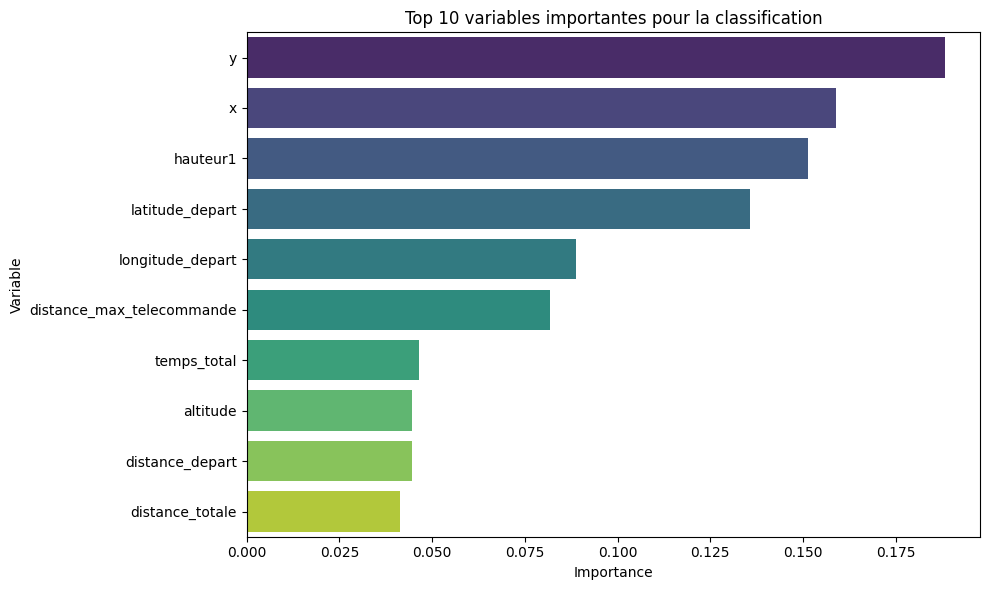

In [118]:
# ----------------------------
# 📦 Imports
# ----------------------------
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import LabelEncoder
from sklearn.impute import SimpleImputer
from sklearn.metrics import classification_report, confusion_matrix
import joblib

# ----------------------------
# 🔧 Nettoyage : suppression des lignes sans cible
# ----------------------------
df_ml = df_clean[df_clean['modele_standardise'].notna()].copy()

# ----------------------------
# Colonnes explicatives sélectionnées
# ----------------------------
colonnes_utiles = [
    'constructeur', 'x', 'y', 'altitude', 'hauteur', 'vitesse', 'hauteur1',
    'vitesse_calculee', 'delta_t', 'vz', 'distance', 'temps_total',
    'distance_totale', 'distance_max_telecommande', 'latitude_depart',
    'longitude_depart', 'distance_depart'
]

# ----------------------------
# Préparation des features (X) et de la cible (y)
# ----------------------------
X = df_ml[colonnes_utiles].copy()
y = df_ml['modele_standardise'].copy()

# Encodage du 'constructeur'
if X['constructeur'].dtype == 'object':
    X['constructeur'] = LabelEncoder().fit_transform(X['constructeur'].astype(str))

# ----------------------------
# Gestion des valeurs infinies
# ----------------------------
X.replace([np.inf, -np.inf], np.nan, inplace=True)

print("🔎 Colonnes avec valeurs manquantes avant imputation :")
print(X.isna().sum()[X.isna().sum() > 0])

# ----------------------------
# Imputation (valeurs manquantes)
# ----------------------------
imputer = SimpleImputer(strategy='median')
X_imputed = pd.DataFrame(imputer.fit_transform(X), columns=X.columns)

# ----------------------------
# Split train / test
# ----------------------------
X_train, X_test, y_train, y_test = train_test_split(
    X_imputed, y, test_size=0.2, random_state=42, stratify=y
)

# ----------------------------
# Entraînement du Random Forest
# ----------------------------
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Prédictions sur test
y_pred = model.predict(X_test)

# ----------------------------
# Évaluation
# ----------------------------
print("\n📈 Rapport de classification :\n")
print(classification_report(y_test, y_pred))

print("🧩 Matrice de confusion :\n")
print(confusion_matrix(y_test, y_pred))

# ----------------------------
# Importance des variables
# ----------------------------
importances = pd.Series(model.feature_importances_, index=X.columns).sort_values(ascending=False)

print("\n🔥 Top 10 variables importantes :")
print(importances.head(10))
print("Taille X_test :", len(X_test))



plt.figure(figsize=(10,6))
sns.barplot(x=importances.head(10), y=importances.head(10).index, palette='viridis')
plt.title("Top 10 variables importantes pour la classification")
plt.xlabel("Importance")
plt.ylabel("Variable")
plt.tight_layout()
plt.show()

# ----------------------------
# Sauvegarde du modèle (optionnel)
# ----------------------------
# joblib.dump(model, "modele_classification_drones.pkl")


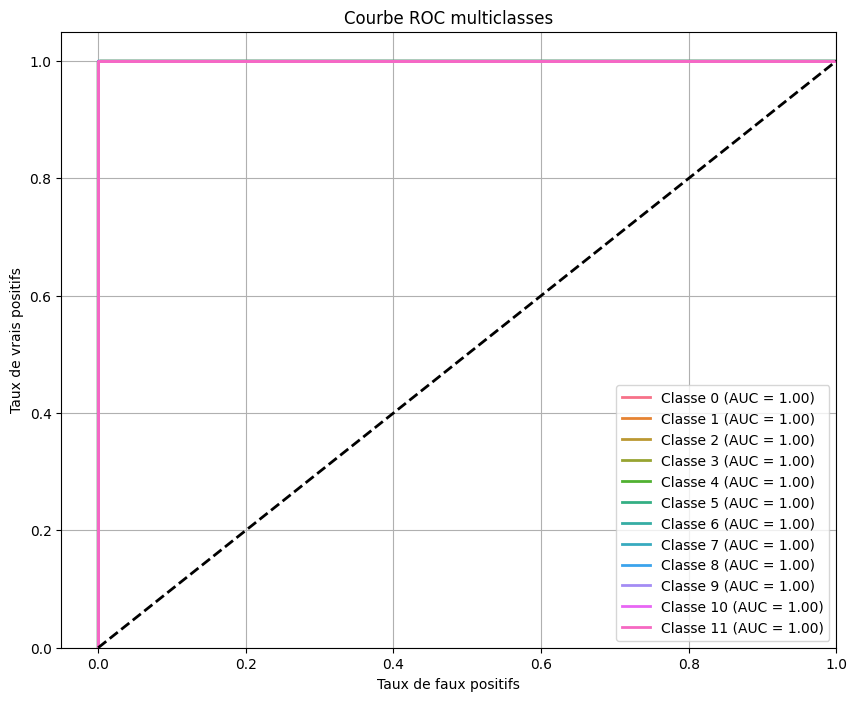


🔍 Test de Kruskal-Wallis (non-paramétrique) :
altitude → H = 10966.11, p = 0.00000e+00
hauteur1 → H = 26373.31, p = 0.00000e+00
vitesse_calculee → H = 6527.40, p = 0.00000e+00
temps_total → H = 14044.74, p = 0.00000e+00

🔬 ANOVA (F-test) :
altitude → F = 470.69, p = 0.00000e+00
hauteur1 → F = 625.67, p = 0.00000e+00
vitesse_calculee → F = 0.15, p = 9.99356e-01
temps_total → F = 327.57, p = 0.00000e+00

📈 QQ Plot pour normalité :


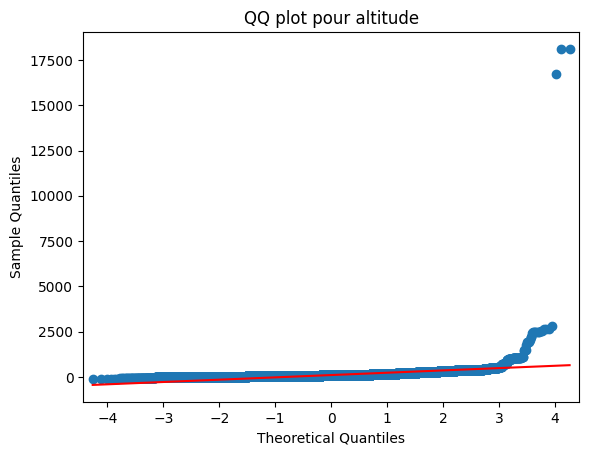

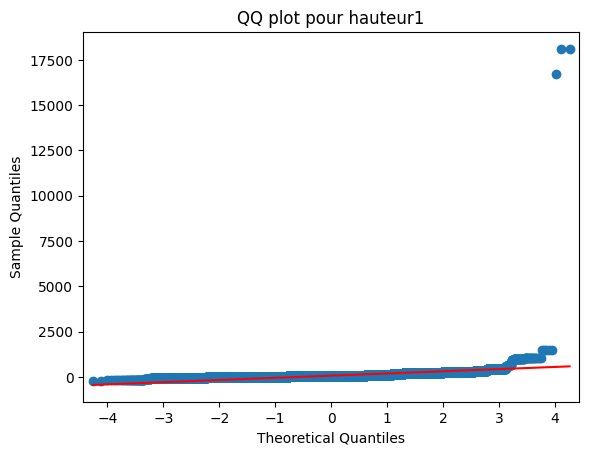

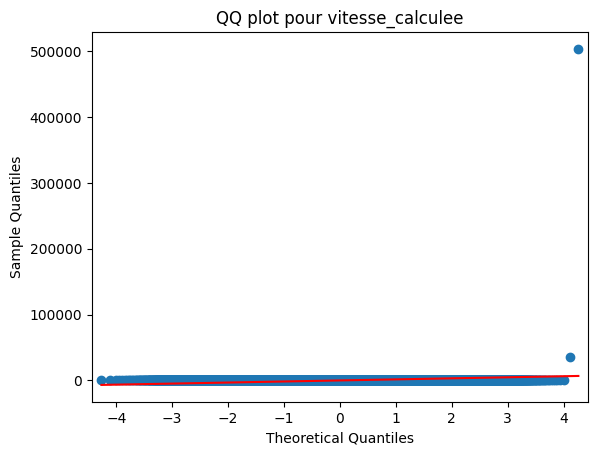

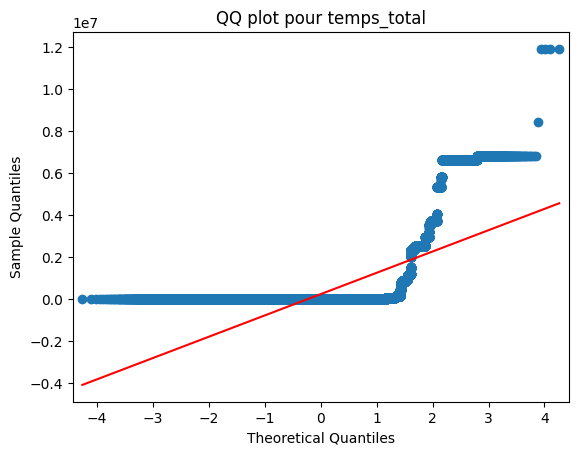

In [122]:
from sklearn.preprocessing import label_binarize
from sklearn.metrics import roc_curve, auc
from sklearn.multiclass import OneVsRestClassifier
from scipy.stats import kruskal, f_oneway, ttest_ind
import statsmodels.api as sm
import statsmodels.formula.api as smf
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# ----------------------------
# ROC & AUC (multiclasse)
# ----------------------------

# Binarisation des classes
y_bin = label_binarize(y_test, classes=np.unique(y))
n_classes = y_bin.shape[1]

# One-vs-Rest
classifier = OneVsRestClassifier(RandomForestClassifier(n_estimators=100, random_state=42))
classifier.fit(X_train, label_binarize(y_train, classes=np.unique(y)))

# Probabilités
y_score = classifier.predict_proba(X_test)

# ROC et AUC
fpr = dict()
tpr = dict()
roc_auc = dict()

for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_bin[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plot
plt.figure(figsize=(10, 8))
colors = sns.color_palette("husl", n_classes)
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'Classe {i} (AUC = {roc_auc[i]:.2f})')
plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([-0.05, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('Taux de faux positifs')
plt.ylabel('Taux de vrais positifs')
plt.title('Courbe ROC multiclasses')
plt.legend(loc='lower right')
plt.grid()
plt.show()

# ----------------------------
# TESTS STATISTIQUES
# ----------------------------

# Exemple avec quelques variables numériques (adapte à ton jeu)
numerical_vars = ['altitude', 'hauteur1', 'vitesse_calculee', 'temps_total']

# Réinitialiser les index pour garantir qu'ils sont alignés
X_aligned = X_imputed.reset_index(drop=True)
y_aligned = y.reset_index(drop=True)

print("\n🔍 Test de Kruskal-Wallis (non-paramétrique) :")
for var in numerical_vars:
    data = [X_aligned[y_aligned == classe][var].dropna() for classe in np.unique(y_aligned)]
    stat, p = kruskal(*data)
    print(f"{var} → H = {stat:.2f}, p = {p:.5e}")


# ANOVA : test de différence des moyennes
print("\n🔬 ANOVA (F-test) :")
for var in numerical_vars:
    data = [X_aligned[y_aligned == classe][var].dropna() for classe in np.unique(y_aligned)]
    stat, p = f_oneway(*data)
    print(f"{var} → F = {stat:.2f}, p = {p:.5e}")



# QQ Plot pour normalité (pour ANOVA)
print("\n📈 QQ Plot pour normalité :")
for var in numerical_vars:
    sm.qqplot(X_imputed[var].dropna(), line='s')
    plt.title(f"QQ plot pour {var}")
    plt.show()


L'AUC (Area Under Curve) de la ROC (Receiver Operating Characteristic) mesure la capacité du modèle à discriminer correctement une classe cible contre toutes les autres (dans le cadre One-vs-Rest).

Recall = 0.92 : 1 instance mal classée sur 12.

Mais si cette instance mal classée avait une proba "presque bonne" (ex : 0.49 vs 0.51 pour l’autre), alors l’ordre des scores était bon → l’AUC reste ≈ 1.00.

Meme avec PRC identique à 1 

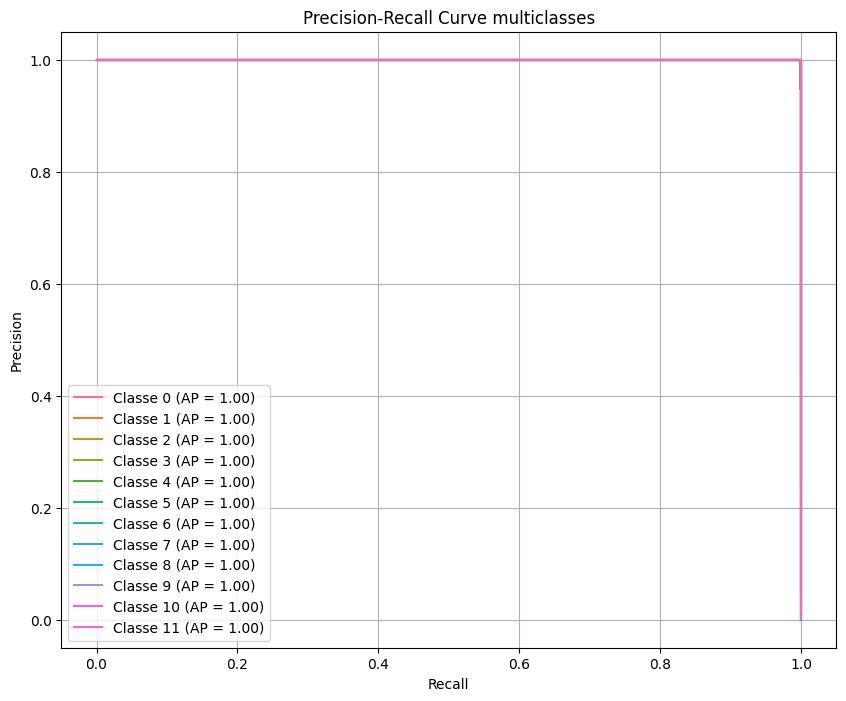

In [121]:
from sklearn.metrics import precision_recall_curve, average_precision_score

# Binarisation des classes (comme pour ROC)
y_bin = label_binarize(y_test, classes=np.unique(y))
n_classes = y_bin.shape[1]

# Prédictions probabilistes (tu as déjà ça)
# y_score = classifier.predict_proba(X_test)

# Dictionnaires pour stocker résultats
precision = dict()
recall = dict()
average_precision = dict()

plt.figure(figsize=(10, 8))
colors = sns.color_palette("husl", n_classes)

for i, color in zip(range(n_classes), colors):
    precision[i], recall[i], _ = precision_recall_curve(y_bin[:, i], y_score[:, i])
    average_precision[i] = average_precision_score(y_bin[:, i], y_score[:, i])
    plt.step(recall[i], precision[i], color=color, where='post',
             label=f'Classe {i} (AP = {average_precision[i]:.2f})')

plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve multiclasses')
plt.legend(loc='best')
plt.grid()
plt.show()


Courbe d'apprentissage

C:\Users\CYTech Student\AppData\Roaming\Python\Python38\site-packages\sklearn\model_selection\_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=5.
  warnings.warn(


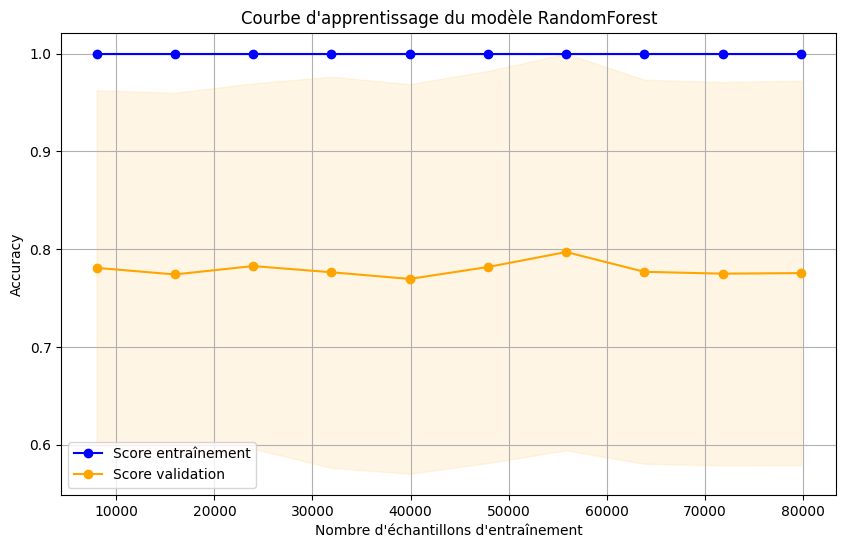

In [123]:
from sklearn.model_selection import learning_curve
from sklearn.ensemble import RandomForestClassifier
import matplotlib.pyplot as plt
import numpy as np

# Supposons que tu as déjà X_imputed et y (tes données complètes)
model = RandomForestClassifier(n_estimators=100, random_state=42)

train_sizes, train_scores, val_scores = learning_curve(
    model,
    X_imputed, y,
    cv=5,            # validation croisée 5-fold
    scoring='accuracy',  # métrique à afficher (ici accuracy)
    train_sizes=np.linspace(0.1, 1.0, 10),  # tailles d'entraînement de 10% à 100%
    n_jobs=-1,
    shuffle=True,
    random_state=42
)

# Moyenne et écart type des scores pour train et validation
train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)
val_mean = np.mean(val_scores, axis=1)
val_std = np.std(val_scores, axis=1)

plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_mean, 'o-', color='blue', label='Score entraînement')
plt.fill_between(train_sizes, train_mean - train_std, train_mean + train_std, alpha=0.1, color='blue')

plt.plot(train_sizes, val_mean, 'o-', color='orange', label='Score validation')
plt.fill_between(train_sizes, val_mean - val_std, val_mean + val_std, alpha=0.1, color='orange')

plt.title("Courbe d'apprentissage du modèle RandomForest")
plt.xlabel("Nombre d'échantillons d'entraînement")
plt.ylabel("Accuracy")
plt.legend(loc="best")
plt.grid()
plt.show()
